In [ ]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
!wget 'https://drive.usercontent.google.com/u/0/uc?id=164aozmikpR81Fs_9YP8DXu2XyUVTRbAS&export=download' -O transactions_archive.csv

--2024-05-26 11:08:14--  https://drive.usercontent.google.com/u/0/uc?id=164aozmikpR81Fs_9YP8DXu2XyUVTRbAS&export=download
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 142.251.162.132, 2607:f8b0:400c:c38::84
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|142.251.162.132|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://drive.usercontent.google.com/uc?id=164aozmikpR81Fs_9YP8DXu2XyUVTRbAS&export=download [following]
--2024-05-26 11:08:14--  https://drive.usercontent.google.com/uc?id=164aozmikpR81Fs_9YP8DXu2XyUVTRbAS&export=download
Reusing existing connection to drive.usercontent.google.com:443.
HTTP request sent, awaiting response... 303 See Other
Location: https://drive.usercontent.google.com/download?id=164aozmikpR81Fs_9YP8DXu2XyUVTRbAS&export=download [following]
--2024-05-26 11:08:14--  https://drive.usercontent.google.com/download?id=164aozmikpR81Fs_9YP8DXu2XyUVTRbAS&export=download
Reusing e

In [ ]:
data = pd.read_csv("transactions_archive.csv")

In [ ]:
data.head()

,id_transaction,date,card,client,date_of_birth,passport,passport_valid_to,phone,operation_type,amount,operation_result,terminal_type,city,address
0,209006609,2024-05-17 00:00:01,550423e5,3-95409,1979-08-28,d76e0791,2024-08-16,a43ddb43,Оплата,229532.3,Успешно,POS,Москва,"Москва, пер. Запрудный, д. 4 стр. 991"
1,262186952,2024-05-17 00:00:04,2f3c6d0e,8-17320,1952-05-01,ffc5420b,бессрочно,f8b325e9,Пополнение,100.0,Успешно,ATM,Санкт-Петербург,"Санкт-Петербург, ш. Звездное, д. 88 стр. 42"
2,644187469,2024-05-17 00:00:05,0646f1f1,8-73435,2000-06-29,5e9c2817,2045-06-18,90f21216,Снятие,2800.0,Успешно,ATM,Москва,"Москва, наб. Карьерная, д. 96 к. 759"
3,208987882,2024-05-17 00:01:26,d6330613,5-20116,1946-07-18,4d2dd87f,бессрочно,598d76c4,Пополнение,3900.0,Успешно,ATM,Москва,"Москва, ш. Павлика Морозова, д. 926 к. 80"
4,707851280,2024-05-17 00:01:39,cc308ab9,3-26968,2002-01-05,e2164664,2046-12-25,8ad20a9e,Пополнение,14800.0,Успешно,ATM,Москва,"Москва, бул. Студенческий, д. 507 стр. 6"


In [ ]:
len(data.city.unique())

48

In [ ]:
data

,card,client,operation_type,amount,operation_result,terminal_type,city,suspicious_activity,passport_expired,transaction_hour,age,time_since_last_transaction,unique_operation_types,card_freq
0,11400,10938,0,229532.30,1,1,20,1,0,0,45,0.0,1,1
1,6385,26340,2,100.00,1,0,32,1,0,0,72,0.0,1,4
2,856,28588,3,2800.00,1,0,20,1,0,0,24,0.0,1,1
3,28608,15241,2,3900.00,1,0,20,1,0,0,78,0.0,1,2
4,27271,8063,2,14800.00,1,0,20,1,0,0,22,0.0,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102407,6232,4692,0,474.56,1,1,39,0,0,11,63,327.0,1,3
102408,6933,1974,1,20841.28,1,2,20,1,0,11,75,0.0,1,1
102409,10627,23383,3,600.00,1,0,20,0,0,11,69,411.0,1,2
102410,30561,30205,0,324866.57,1,2,20,1,0,11,44,0.0,1,1


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 102412 entries, 0 to 102411
Data columns (total 14 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   id_transaction     102412 non-null  int64  
 1   date               102412 non-null  object 
 2   card               102412 non-null  object 
 3   client             102412 non-null  object 
 4   date_of_birth      102412 non-null  object 
 5   passport           102412 non-null  object 
 6   passport_valid_to  102412 non-null  object 
 7   phone              102412 non-null  object 
 8   operation_type     102412 non-null  object 
 9   amount             102412 non-null  float64
 10  operation_result   102412 non-null  object 
 11  terminal_type      102412 non-null  object 
 12  city               102412 non-null  object 
 13  address            102412 non-null  object 
dtypes: float64(1), int64(1), object(12)
memory usage: 10.9+ MB


# Обработка

In [ ]:
def preprocessing_dataset2(data):
  data['date'] = pd.to_datetime(data['date'])
  data['date_of_birth'] = pd.to_datetime(data['date_of_birth'], errors='coerce')
  data['passport_valid_to'] = pd.to_datetime(data['passport_valid_to'], errors='coerce', format='%Y-%m-%d', exact=False)
  data['passport_expired'] = data['passport_valid_to'] < data['date']
  data['passport_expired'] = data['passport_expired'].astype(int)

  clients_last_transaction = {}
  data['transaction_count'] = 0
  for index, row in data.iterrows():
      client = row['client']
      date = row['date']

      if client in clients_last_transaction:
          last_transaction, count = clients_last_transaction[client]

          if (date - last_transaction).total_seconds() < 60:
              count += 1
          else:
              count = 1
      else:
          count = 1
      clients_last_transaction[client] = (date, count)
      data.at[index, 'transaction_count'] = count

  clients_last_city = {}
  data['city_changed'] = 0

  for index, row in data.sort_values(by='date').iterrows():
      client = row['client']
      date = row['date']
      city = row['city']

      if client in clients_last_city:
          last_city_info = clients_last_city[client]
          last_city, last_city_time = last_city_info

          if city != last_city and (date - last_city_time).total_seconds() < 600 :
              data.at[index, 'city_changed'] = 1
          else:
              data.at[index, 'city_changed'] = 0
      else:
          data.at[index, 'city_changed'] = 0
      clients_last_city[client] = (city, date)

  label_encoders = {}
  for column in ['card', 'client', 'operation_type', 'operation_result', 'terminal_type', 'city']:
      le = LabelEncoder()
      data[column] = le.fit_transform(data[column])
      label_encoders[column] = le

  data['transaction_year'] = data['date'].dt.year
  data['transaction_month'] = data['date'].dt.month
  data['transaction_day'] = data['date'].dt.day
  data['transaction_hour'] = data['date'].dt.hour
  data['age'] = data['transaction_year'] - data['date_of_birth'].dt.year

  data['time_last_transaction'] = data.groupby('client')['date'].diff().dt.total_seconds().fillna(999)

  data.drop(columns=['id_transaction','passport_valid_to', 'date', 'date_of_birth','transaction_year', 'transaction_month', 'passport', 'phone', 'address'], inplace=True)

  card_counts = data['card'].value_counts()
  data['card_freq'] = data['card'].map(card_counts)

  data.drop(columns=["card"], inplace=True)
  return data
#data = preprocessing_dataset(data)

In [ ]:
def mark_suspicious_transactions(data, increase_percentage_threshold=1000):

    data_copy = data.copy()

    data_copy['date'] = pd.to_datetime(data_copy['date'])

    suspicious_activity = pd.Series(0, index=data_copy.index)

    data_copy.sort_values(by=['client', 'date'], inplace=True)

    for client_id, group in data_copy.groupby('client'):
        previous_amount = None
        previous_city = None
        first_transaction_flag = True

        for index, row in group.iterrows():
            if first_transaction_flag:
                suspicious_activity.at[index] = 1
                first_transaction_flag = False
            elif previous_amount is not None and previous_city is not None:
                if (row['amount'] > previous_amount * (1 + increase_percentage_threshold / 100)) and (row['city'] != previous_city):
                    suspicious_activity.at[index] = 1

            previous_amount = row['amount']
            previous_city = row['city']

    return suspicious_activity

def determine_time_of_day(hour):
    if 0 <= hour < 6:
        return 0 # ночь
    elif 6 <= hour < 12:
        return 1 # утро
    elif 12 <= hour < 18:
        return 2 # день
    else:
        return 3 # вечер

def preprocessing_dataset(data, onehot = False):
    # Заполняем пропущенные значения
    data['suspicious_activity'] = mark_suspicious_transactions(data, increase_percentage_threshold=1000)
    data['passport_valid_to'].fillna('Unknown', inplace=True)
    data['operation_result'].fillna('Неизвестно', inplace=True)
    data['amount'].fillna(data['amount'].median(), inplace=True)

    # Переводим в формат datetime
    data['date'] = pd.to_datetime(data['date'])
    data['date_of_birth'] = pd.to_datetime(data['date_of_birth'], errors='coerce')
    data['passport_valid_to'] = pd.to_datetime(data['passport_valid_to'], errors='coerce', format='%Y-%m-%d', exact=False)

    # Смотрим, просрочился ли паспорт
    data['passport_expired'] = data['passport_valid_to'] < data['date']
    data['passport_expired'] = data['passport_expired'].astype(int)

    # Достаем год, месяц, день час из времени
    data['transaction_year'] = data['date'].dt.year
    data['transaction_hour'] = data['date'].dt.hour

    # Создаем новые фичи
    data['age'] = data['transaction_year'] - data['date_of_birth'].dt.year
    data['age'].fillna(data['age'].mean(), inplace=True)
    data['time_since_last_transaction'] = data.groupby('client')['date'].diff().dt.total_seconds().fillna(0)
    data['unique_operation_types'] = data.groupby('client')['operation_type'].transform('nunique')
    card_counts = data['card'].value_counts()
    data['card_freq'] = data['card'].map(card_counts)

    # Дропаем ненужные нам колонки
    data.drop(columns=['id_transaction', 'date', 'date_of_birth', 'passport', 'phone', 'address', 'transaction_year', 'passport_valid_to'], inplace=True)

    # Кодирование категориальных признаков с помощью Label Encoder
    if (onehot):
      columns_for_label_encoder = ['card', 'client']
    else:
      columns_for_label_encoder = ['card', 'client', 'operation_type', 'operation_result', 'terminal_type', 'city']
    label_encoders = {}
    for column in columns_for_label_encoder:
        le = LabelEncoder()
        data[column] = le.fit_transform(data[column])
        label_encoders[column] = le

    # One-hot encoding
    if (onehot):
      data = pd.get_dummies(data)

    return data


data = preprocessing_dataset(data)

In [ ]:
data

,card,client,operation_type,amount,operation_result,terminal_type,city,suspicious_activity,passport_expired,transaction_hour,age,time_since_last_transaction,unique_operation_types,card_freq
0,11400,10938,0,229532.30,1,1,20,1,0,0,45,0.0,1,1
1,6385,26340,2,100.00,1,0,32,1,0,0,72,0.0,1,4
2,856,28588,3,2800.00,1,0,20,1,0,0,24,0.0,1,1
3,28608,15241,2,3900.00,1,0,20,1,0,0,78,0.0,1,2
4,27271,8063,2,14800.00,1,0,20,1,0,0,22,0.0,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102407,6232,4692,0,474.56,1,1,39,0,0,11,63,327.0,1,3
102408,6933,1974,1,20841.28,1,2,20,1,0,11,75,0.0,1,1
102409,10627,23383,3,600.00,1,0,20,0,0,11,69,411.0,1,2
102410,30561,30205,0,324866.57,1,2,20,1,0,11,44,0.0,1,1


# Вывод графиков

In [ ]:
data.head()

,card,client,passport_valid_to,operation_type,amount,operation_result,terminal_type,city,passport_expired,transaction_year,transaction_month,transaction_day,transaction_hour,age,time_since_last_transaction,unique_operation_types
0,11400,10938,2024-08-16,0,229532.3,1,1,20,0,2024,5,17,0,45,0.0,1
1,6385,26340,NaT,2,100.0,1,0,32,0,2024,5,17,0,72,0.0,1
2,856,28588,2045-06-18,3,2800.0,1,0,20,0,2024,5,17,0,24,0.0,1
3,28608,15241,NaT,2,3900.0,1,0,20,0,2024,5,17,0,78,0.0,1
4,27271,8063,2046-12-25,2,14800.0,1,0,20,0,2024,5,17,0,22,0.0,1


In [ ]:
data.isnull().sum()

card                               0
client                             0
passport_valid_to              55378
operation_type                     0
amount                             0
operation_result                   0
terminal_type                      0
city                               0
passport_expired                   0
transaction_year                   0
transaction_month                  0
transaction_day                    0
transaction_hour                   0
age                                0
time_since_last_transaction        0
unique_operation_types             0
dtype: int64

In [ ]:
card_counts = data['card'].value_counts()
data['card_freq'] = data['card'].map(card_counts)

data[['card', 'card_freq']].head()

,card,card_freq
0,11400,1
1,6385,4
2,856,1
3,28608,2
4,27271,2


In [ ]:
data.head()

,card,client,passport_valid_to,operation_type,amount,operation_result,terminal_type,city,passport_expired,transaction_year,transaction_month,transaction_day,transaction_hour,age,time_since_last_transaction,unique_operation_types,card_freq
0,11400,10938,2024-08-16,0,229532.3,1,1,20,0,2024,5,17,0,45,0.0,1,1
1,6385,26340,NaT,2,100.0,1,0,32,0,2024,5,17,0,72,0.0,1,4
2,856,28588,2045-06-18,3,2800.0,1,0,20,0,2024,5,17,0,24,0.0,1,1
3,28608,15241,NaT,2,3900.0,1,0,20,0,2024,5,17,0,78,0.0,1,2
4,27271,8063,2046-12-25,2,14800.0,1,0,20,0,2024,5,17,0,22,0.0,1,2


In [ ]:
data.drop(columns=["card"], inplace=True)

<ipython-input-24-9ed424030030>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='transaction_hour', data=data, palette='viridis')


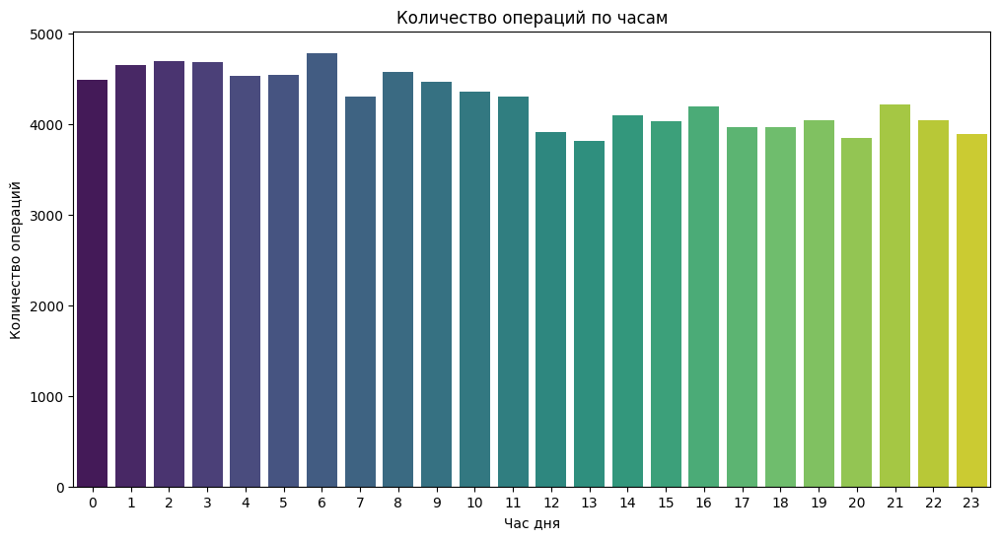

In [ ]:
# Построение графика количества операций по часам
plt.figure(figsize=(12, 6))
sns.countplot(x='transaction_hour', data=data, palette='viridis')
plt.title('Количество операций по часам')
plt.xlabel('Час дня')
plt.ylabel('Количество операций')
plt.show()

#

# Построение модели

In [ ]:
def transaction_output_by_id(data, number_clinet):
    return data[data["client"] == number_clinet]

In [ ]:
import plotly.express as px
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
import numpy as np

def train_dbs(data, dbs_eps, dbs_min_samples, dbs_leaf_size):
  #tsne = TSNE(n_components=2, random_state=42)
  #embedded_data = tsne.fit_transform(data)
  dbscan = DBSCAN(eps=10000, min_samples=500, leaf_size = 50)
  clusters = dbscan.fit_predict(data)
  #pca = PCA(n_components=2)
  #data2 = pca.fit_transform(data)

  #df_pca = pd.DataFrame(data=data2, columns=['pc1', 'pc2'])
  df_pca = data

  df_pca["cluster"] = clusters

  #plt.scatter(data2[:, 0], data2[:, 1], c=clusters)
  #plt.title("DBSCAN кластеризация с t-SNE", title=f"Isolation Forest Clasterization. Info loss in visualisation - {round(1-sum(pca.explained_variance_ratio_), 3)}%")
  #plt.show()
  fig = px.scatter(df_pca, x="pc1", y="pc2", color='cluster')

  fig.show()
  print(np.count_nonzero(clusters==0))
  print(np.count_nonzero(clusters==1))

In [ ]:
def pca(data, dim):
  pca = PCA(n_components=2)
  print(data.head())
  data2 = pca.fit_transform(data)
  df_pca = pd.DataFrame(data=data2, columns=['pc1', 'pc2'])
  print(len(data))
  print(len(pca.components_[0]))
  print(len(pca.components_[1]))

  fig = px.scatter(df_pca, x="pc1", y="pc2")
  fig.show()

In [ ]:
pca(data,1)

    card  client  operation_type    amount  operation_result  terminal_type  \
0  11400   10938               0  229532.3                 1              1   
1   6385   26340               2     100.0                 1              0   
2    856   28588               3    2800.0                 1              0   
3  28608   15241               2    3900.0                 1              0   
4  27271    8063               2   14800.0                 1              0   

   city  suspicious_activity  passport_expired  transaction_hour  age  \
0    20                    1                 0                 0   45   
1    32                    1                 0                 0   72   
2    20                    1                 0                 0   24   
3    20                    1                 0                 0   78   
4    20                    1                 0                 0   22   

   time_since_last_transaction  unique_operation_types  card_freq  
0                 

## Clusterize

In [ ]:

import plotly.express as px
def train_models2(data):
  client_data = data.loc[:, ['client', 'card']]
  data = data.drop(columns = ['client', 'card'])

  isolation_forest = IsolationForest(n_estimators = 400, contamination=0.015, max_features = 4, verbose = 32, bootstrap = True)
  isolation_forest.fit(data)
  anomaly_score = isolation_forest.decision_function(data)
  anomaly = isolation_forest.predict(data)

  pca = PCA(n_components=3)
  data2 = pca.fit_transform(data)
  df_pca = pd.DataFrame(data=data2, columns=['pc1', 'pc2', 'pc3'])
  df_pca['anomaly_score'] = anomaly_score
  df_pca['anomaly'] = anomaly
  df_pca['anomaly'] = df_pca['anomaly'].map({1: 0, -1: 1})  # 1 - аномалия, 0 - нормальная
  df_pca.drop(columns=['anomaly_score'])
  df = df_pca

  import plotly.express as px
  #df = px.data.iris()
  fig = px.scatter_3d(df_pca, x='pc1', y='pc2', z='pc3',
                color='anomaly')
  fig.show()

  # Create the figure
  fig = plt.figure()
  ax = fig.add_subplot(111, projection='3d')

  # Generate the values
  x_vals = df_pca.iloc[:, 0:1]
  y_vals = df_pca.iloc[:, 1:2]
  z_vals = df_pca.iloc[:, 2:3]

  # Plot the values
  ax.scatter(x_vals, y_vals, z_vals, c = 'b', marker='o')
  ax.set_xlabel('X-axis')
  ax.set_ylabel('Y-axis')
  ax.set_zlabel('Z-axis')

  plt.show()

In [ ]:
pip install dash

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 13.8 MB/s eta 0:00:00


In [ ]:
b

,pc1,pc2,anomaly_score,anomaly
0,169336.360917,-1791.936272,0.069629,0
1,-60095.937661,-1820.169900,0.063260,0
2,-57395.937112,-1819.837710,0.091953,0
3,-56295.937759,-1819.702269,0.097549,0
4,-45395.937176,-1818.361009,0.093005,0
...,...,...,...,...
102407,-59721.417789,-1493.123814,0.080929,0
102408,-39354.657844,-1817.617494,0.062893,0
102409,-59595.988208,-1409.108375,0.139149,0
102410,264670.630202,-1780.204548,0.058810,0


In [ ]:
import plotly.express as px
def train_models(data):
  client_data = data.loc[:, ['client', 'card']]
  data = data.drop(columns = ['client', 'card'])

  isolation_forest = IsolationForest(n_estimators = 300, contamination=0.01, random_state=42, max_features = 5)
  isolation_forest.fit(data)
  anomaly_score = isolation_forest.decision_function(data)
  anomaly = isolation_forest.predict(data)

  pca = PCA(n_components=2)
  data2 = pca.fit_transform(data)
  df_pca = pd.DataFrame(data=data2, columns=['pc1', 'pc2'])
  df_pca['anomaly_score'] = anomaly_score
  df_pca['anomaly'] = anomaly
  df_pca['anomaly'] = df_pca['anomaly'].map({1: 0, -1: 1})  # 1 - аномалия, 0 - нормальная
  df_pca.drop(columns=['anomaly_score'])
  df = df_pca
  fig = px.scatter(df, x="pc1", y="pc2", color='anomaly',title=f"Isolation Forest Clasterization. Info loss in visualisation - {round(1-sum(pca.explained_variance_ratio_))}%", color_discrete_map={0:'yellow', 1:'green'})
  data['anomaly'] = df_pca['anomaly']
  fig.show()
  print('frauds:', np.count_nonzero(anomaly==-1))
  print('non frauds:', np.count_nonzero(anomaly==1))
  return client_data, df_pca, data





Building estimator 1 of 400 for this parallel run (total 400)...
Building estimator 2 of 400 for this parallel run (total 400)...
Building estimator 3 of 400 for this parallel run (total 400)...
Building estimator 4 of 400 for this parallel run (total 400)...
Building estimator 5 of 400 for this parallel run (total 400)...
Building estimator 6 of 400 for this parallel run (total 400)...
Building estimator 7 of 400 for this parallel run (total 400)...
Building estimator 8 of 400 for this parallel run (total 400)...
Building estimator 9 of 400 for this parallel run (total 400)...
Building estimator 10 of 400 for this parallel run (total 400)...
Building estimator 11 of 400 for this parallel run (total 400)...
Building estimator 12 of 400 for this parallel run (total 400)...
Building estimator 13 of 400 for this parallel run (total 400)...
Building estimator 14 of 400 for this parallel run (total 400)...
Building estimator 15 of 400 for this parallel run (total 400)...
Building estimator 

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    1.7s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    1.7s
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but IsolationForest was fitted with feature names



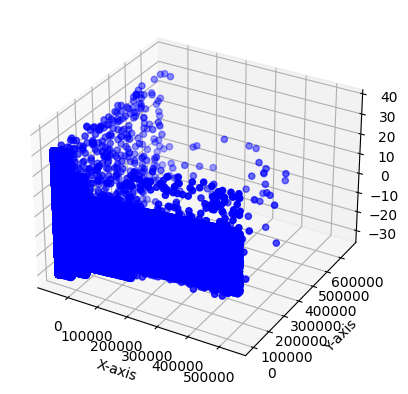

In [ ]:
train_models2(data)

In [ ]:
b

,pc1,pc2,anomaly_score,anomaly
0,169336.360917,-1791.936272,0.069629,0
1,-60095.937661,-1820.169900,0.063260,0
2,-57395.937112,-1819.837710,0.091953,0
3,-56295.937759,-1819.702269,0.097549,0
4,-45395.937176,-1818.361009,0.093005,0
...,...,...,...,...
102407,-59721.417789,-1493.123814,0.080929,0
102408,-39354.657844,-1817.617494,0.062893,0
102409,-59595.988208,-1409.108375,0.139149,0
102410,264670.630202,-1780.204548,0.058810,0


In [ ]:
a, b, classdata = train_models(data)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but IsolationForest was fitted with feature names



frauds: 1025
non frauds: 101387


In [ ]:
sec = pd.concat([a, b], axis = 1)
sec[sec['anomaly']==1].sort_values(by = 'pc1', ascending = False)

## Inference

In [ ]:
!pip install dash

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 11.7 MB/s eta 0:00:00


In [ ]:
import dash_core_components as dcc

In [ ]:
#def dash(data):
import dash
import dash_core_components as dcc
import dash_html_components as html
import plotly.graph_objs as go
import joblib
import plotly.express as px
from sklearn.decomposition import PCA
def graphic(batch_data):
  b = preprocessing_dataset2(batch_data)
  # Создаем данные для графика
  user_data = b['client']
  loaded_model = joblib.load('random_forest.joblib')
  predictions = loaded_model.predict_proba(b)[:, 1]
  pca = PCA(n_components=2)
  pcc = pca.fit_transform(b)
  b_pca = pd.DataFrame(data = pcc, columns = ['pc1', 'pc2'])
  b_pca['fraud_prob'] = predictions
  b_pca['client'] = b['client']
  # Создаем график с помощью Plotly
  #graph = go.Scatter(x=x_data, y=y_data, mode='lines', name='График')
  fig = px.scatter(b_pca, x="pc1", y="pc2", color = 'fraud_prob', text = 'client', width=800, height=800)
  fig2 = px.histogram(b, x = 'amount', width=800, height=800)
  fig3 = px.histogram(b, x = 'age', width=800, height=550)
  fig4 = px.histogram(b, x = 'card_freq', width=800, height=550)
  fig5 = px.histogram(b, x = 'city', width=800, height=550)
  #, y = 'count')
  # Создаем макет для Dash-приложения
  app = dash.Dash()
  app.layout = html.Div(children=[
      dcc.Graph(
          id='example-graph',
          figure=fig

      ),dcc.Graph(
          id='example-graph2',
          figure=fig2

      ),dcc.Graph(
          id='example-graph3',
          figure=fig3

      ),dcc.Graph(
          id='example-graph5',
          figure=fig5

      )
  ])

  # Запускаем Dash-приложение
  if __name__ == '__main__':
      app.run_server(debug=True)
graphic(data)

<IPython.core.display.Javascript object>

In [ ]:
import dash
from dash import dcc, html
import plotly.express as px
import pandas as pd
from dash.dependencies import Input, Output

# Предполагается, что у вас уже есть DataFrame `b_pca` с информацией о client_id
# и что вы уже обработали данные и создали scatter plot `fig`
batch_data = data
b = preprocessing_dataset2(batch_data)
  # Создаем данные для графика

user_data = b['client']
loaded_model = joblib.load('random_forest.joblib')
predictions = loaded_model.predict_proba(b)[:, 1]
pca = PCA(n_components=2)
pcc = pca.fit_transform(b)
b_pca = pd.DataFrame(data = pcc, columns = ['pc1', 'pc2'])
b_pca['fraud_prob'] = predictions
b_pca['client'] = b['client']
app = dash.Dash(__name__)

app.layout = html.Div([
    html.H1('Интерактивный график с информацией о клиентах'),
    dcc.Graph(
        id='scatter-plot',
        figure=fig
    ),
    html.Div(id='client-info', children='Выберите точку на графике')
])

@app.callback(
    Output('client-info', 'children'),
    [Input('scatter-plot', 'clickData')]
)
def display_client_info(clickData):
    if clickData is not None:
        # Извлекаем client_id из данных, полученных при клике
        client_id = clickData['points'][0]['text']
        # Находим информацию о клиенте в DataFrame
        client_data = b_pca[b_pca['client_id'] == client_id]
        # Преобразуем информацию о клиенте в строку HTML
        return html.Table([
            html.Thead(html.Tr([html.Th(col) for col in client_data.columns])),
            html.Tbody([html.Tr([html.Td(client_data.iloc[0][col]) for col in client_data.columns])])
        ])
    return 'Выберите точку на графике'

if __name__ == '__main__':
    app.run_server(debug=True)

<IPython.core.display.Javascript object>

In [ ]:
#def dash(data):
import dash
import dash_core_components as dcc
import dash_html_components as html
import plotly.graph_objs as go
import joblib
from sklearn.decomposition import PCA
def graphic(batch_data):
  b = preprocessing_dataset2(batch_data)
  # Создаем данные для графика
  loaded_model = joblib.load('random_forest.joblib')
  predictions = loaded_model.predict_proba(b)[:, 1]
  pca = PCA(n_components=2)
  pcc = pca.fit_transform(b)
  b_pca = pd.DataFrame(data = pcc, columns = ['pc1', 'pc2'])
  b_pca['fraud_prob'] = predictions
  # Создаем график с помощью Plotly
  #graph = go.Scatter(x=x_data, y=y_data, mode='lines', name='График')
  fig = px.scatter(b_pca, x="pc1", y="pc2", color = 'fraud_prob', width=800, height=400)
  fig2 = px.histogram(b, x = 'amount', width=800, height=400)
  fig3 = px.histogram(b, x = 'age', width=800, height=400)
  fig4 = px.histogram(b, x = 'card_freq', width=800, height=400)
  fig5 = px.histogram(b, x = 'city', width=800, height=400)
  #, y = 'count')
  # Создаем макет для Dash-приложения
  app = dash.Dash()
  app.layout = html.Div(children=[
      html.H1(children='Мой график'),
      dcc.Graph(
          id='example-graph',
          figure=fig

      ),dcc.Graph(
          id='example-graph2',
          figure=fig2

      ),dcc.Graph(
          id='example-graph3',
          figure=fig3

      ),dcc.Graph(
          id='example-graph5',
          figure=fig5

      )
  ])

  # Запускаем Dash-приложение
  if __name__ == '__main__':
      app.run_server(debug=True)
graphic(data)

<IPython.core.display.Javascript object>

## Classify

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
def classify(data):

  y = data['anomaly']

  X = data.drop(columns=['anomaly'])

  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

  model = RandomForestClassifier(n_estimators=100, random_state=42)
  model.fit(X_train, y_train)

  feature_importances = model.feature_importances_
  features = X.columns

  data['fraud_probability'] = model.predict_proba(X)[:, 1]
  importance_df = pd.DataFrame({
    'Feature': features,
    'Importance': feature_importances
  }).sort_values(by='Importance', ascending=False)

  plt.figure(figsize=(12, 6))
  sns.barplot(x='Importance', y='Feature', data=importance_df)
  plt.title('Важность признаков для модели Random Forest')
  plt.xlabel('Важность')
  plt.ylabel('Признак')
  plt.show()
  fraud_probability_counts = data['fraud_probability'].value_counts()
  print("Counts of each unique fraud probability value:")
  print(fraud_probability_counts)

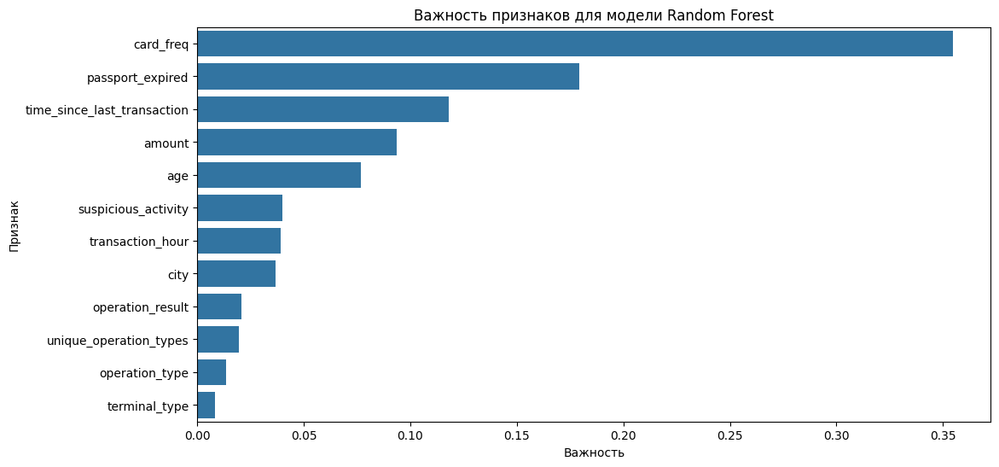

Counts of each unique fraud probability value:
fraud_probability
0.00    100283
0.01       723
1.00       398
0.02       210
0.03       112
         ...  
0.29         1
0.42         1
0.59         1
0.31         1
0.34         1
Name: count, Length: 94, dtype: int64


In [ ]:
classify(classdata)

In [ ]:
import plotly.express as px
def train_models_pca(data, cont, estim):
  client_data = data.loc[:, ['client', 'card']]
  data = data.drop(columns = ['client', 'card'])
  pca = PCA(n_components=2)
  data2 = pca.fit_transform(data)

  isolation_forest = IsolationForest(n_estimators = estim, contamination=cont, random_state=50, max_features =1)
  isolation_forest.fit(data2)
  anomaly_score = isolation_forest.decision_function(data2)
  anomaly = isolation_forest.predict(data2)

  df_frst = pd.DataFrame(data=data2, columns=['pc1', 'pc2'])
  df_frst['anomaly_score'] = anomaly_score
  df_frst['anomaly'] = anomaly
  df_frst['anomaly'] = df_frst['anomaly'].map({1: 0, -1: 1})  # 1 - аномалия, 0 - нормальная
  df_frst.drop(columns=['anomaly_score'])
  df = df_frst
  fig = px.scatter(df, x="pc1", y="pc2", color='anomaly',title=f"Isolation Forest Clasterization. Info loss in visualisation - {round(1-sum(pca.explained_variance_ratio_))}%")

  fig.show()
  print(np.count_nonzero(anomaly==-1))
  print(np.count_nonzero(anomaly==1))


  return client_data, df_frst





In [ ]:
import plotly.express as px
import plotly.express as px
def train_models_pca2(data, cont, estim):
  client_data = data.loc[:, ['client', 'card']]
  data = data.drop(columns = ['client', 'card'])
  pca = PCA(n_components=3)
  data2 = pca.fit_transform(data)

  isolation_forest = IsolationForest(n_estimators = estim, contamination=cont, random_state=50, max_features =1)
  isolation_forest.fit(data2)
  anomaly_score = isolation_forest.decision_function(data2)
  anomaly = isolation_forest.predict(data2)

  df_frst = pd.DataFrame(data=data2, columns=['pc1', 'pc2', 'pc3'])
  df_frst['anomaly_score'] = anomaly_score
  df_frst['anomaly'] = anomaly
  df_frst['anomaly'] = df_frst['anomaly'].map({1: 0, -1: 1})  # 1 - аномалия, 0 - нормальная
  df_frst.drop(columns=['anomaly_score'])
  df = df_frst
  #fig = px.scatter(df, x="pc1", y="pc2", color='anomaly',title=f"Isolation Forest Clasterization. Info loss in visualisation - {round(1-sum(pca.explained_variance_ratio_))}%")

  #fig.show()
  print(np.count_nonzero(anomaly==-1))
  print(np.count_nonzero(anomaly==1))

  #df = px.data.iris()
  fig = px.scatter_3d(df_frst, x='pc1', y='pc2', z='pc3',
                color='anomaly')
  fig.show()

  # Create the figure
  fig = plt.figure()
  ax = fig.add_subplot(111, projection='3d')

  # Generate the values
  x_vals = df_frst.iloc[:, 0:1]
  y_vals = df_frst.iloc[:, 1:2]
  z_vals = df_frst.iloc[:, 2:3]

  # Plot the values
  ax.scatter(x_vals, y_vals, z_vals, c = 'b', marker='o')
  ax.set_xlabel('X-axis')
  ax.set_ylabel('Y-axis')
  ax.set_zlabel('Z-axis')

  plt.show()


  return client_data, df_frst

461
101951


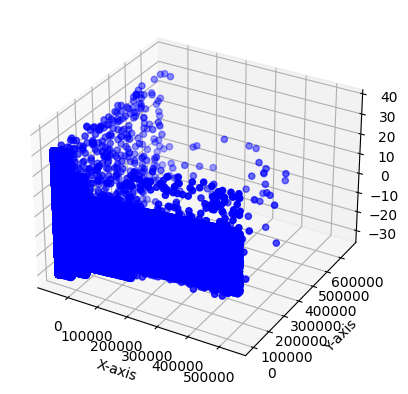

(        client   card
 0        10938  11400
 1        26340   6385
 2        28588    856
 3        15241  28608
 4         8063  27271
 ...        ...    ...
 102407    4692   6232
 102408    1974   6933
 102409   23383  10627
 102410   30205  30561
 102411   28392  18990
 
 [102412 rows x 2 columns],
                   pc1          pc2        pc3  anomaly_score  anomaly
 0       169336.360917 -1791.936272  -1.057906       0.061151        0
 1       -60095.937661 -1820.169900  23.237189       0.144715        0
 2       -57395.937112 -1819.837710 -24.750221       0.168419        0
 3       -56295.937759 -1819.702269  29.262795       0.140824        0
 4       -45395.937176 -1818.361009 -26.605871       0.081244        0
 ...               ...          ...        ...            ...      ...
 102407  -59721.417789 -1493.123814  14.180152       0.149987        0
 102408  -39354.657844 -1817.617494  26.397954       0.072565        0
 102409  -59595.988208 -1409.108375  20.167708       0.

In [ ]:
#cd, frst =train_models_pca2(data, 0.0045, 300)
train_models_pca(data, 0.0045, 300)


In [ ]:
sec = pd.concat([cd, frst], axis = 1)
sec[sec['anomaly']==1].sort_values(by = 'pc1', ascending = False)

,client,card,pc1,pc2,anomaly_score,anomaly
22666,27344,32903,539723.156125,-1160.356927,-0.059095,1
80828,14784,25431,539240.626557,-1166.416271,-0.058936,1
23505,16423,28337,539208.558753,-1182.420244,-0.053266,1
89677,12526,13506,538804.837664,-1174.469911,-0.056247,1
71341,25871,17125,538718.900237,-1195.480480,-0.043152,1
...,...,...,...,...,...,...
81034,3636,16901,-42766.477915,571408.966920,-0.021964,1
63266,20889,3968,-45280.255196,133385.654247,-0.002443,1
80046,9951,15664,-45429.175355,248615.636807,-0.010958,1
99955,5870,33573,-48000.651682,531619.322536,-0.009570,1


In [ ]:
train_dbs(data[:50000], dbs_eps = 2000, dbs_min_samples = 5000, dbs_leaf_size = 30)

In [ ]:
transaction_output_by_id(data, 3446)

,card,client,operation_type,amount,operation_result,terminal_type,city,suspicious_activity,passport_expired,transaction_hour,age,time_since_last_transaction,unique_operation_types,card_freq
3428,8301,3446,3,400.0,0,0,13,1,0,7,25,0.0,1,5
3466,8301,3446,3,200.0,1,0,13,0,0,7,25,225.0,1,5
3522,8301,3446,3,900.0,1,0,13,0,0,7,25,496.0,1,5
3613,8301,3446,3,900.0,0,0,13,0,0,7,25,590.0,1,5
3679,8301,3446,3,200.0,1,0,13,0,0,7,25,438.0,1,5
96422,3933,3446,3,4600.0,1,0,32,1,0,0,78,665460.0,1,1


In [ ]:
data.describe()

,card,client,operation_type,amount,operation_result,terminal_type,city,suspicious_activity,passport_expired,transaction_hour,age,time_since_last_transaction,unique_operation_types,card_freq
count,102412.000000,102412.000000,102412.000000,102412.000000,102412.000000,102412.000000,102412.000000,102412.000000,102412.000000,102412.000000,102412.000000,102412.000000,102412.000000,102412.000000
mean,17084.545210,16707.646262,1.376294,60196.160907,0.696784,0.759638,20.067853,0.327940,0.006523,11.098367,48.122456,1812.774587,1.201148,3.728879
std,9860.280891,9639.748846,1.216390,124122.123370,0.459650,0.835524,5.567428,0.469465,0.080500,6.937535,16.744157,24383.894667,0.400861,1.504301
min,0.000000,0.000000,0.000000,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.000000,0.000000,1.000000,1.000000
25%,8515.000000,8414.750000,0.000000,942.530000,0.000000,0.000000,20.000000,0.000000,0.000000,5.000000,34.000000,0.000000,1.000000,3.000000
50%,17104.500000,16654.500000,1.000000,3680.365000,1.000000,1.000000,20.000000,0.000000,0.000000,11.000000,48.000000,196.000000,1.000000,4.000000
75%,25628.000000,25052.000000,3.000000,50000.000000,1.000000,2.000000,20.000000,1.000000,0.000000,17.000000,61.000000,402.000000,1.000000,5.000000
max,34103.000000,33441.000000,3.000000,599990.850000,1.000000,2.000000,47.000000,1.000000,1.000000,23.000000,80.000000,665460.000000,2.000000,16.000000


In [ ]:
from sklearn.ensemble import IsolationForest
train_models(data)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but IsolationForest was fitted with feature names



1025
101387


,pc1,pc2,anomaly_score,anomaly
0,169336.360917,-1791.936272,0.066610,0
1,-60095.937661,-1820.169900,0.055385,0
2,-57395.937112,-1819.837710,0.077986,0
3,-56295.937759,-1819.702269,0.091163,0
4,-45395.937176,-1818.361009,0.085155,0
...,...,...,...,...
102407,-59721.417789,-1493.123814,0.099985,0
102408,-39354.657844,-1817.617494,0.063516,0
102409,-59595.988208,-1409.108375,0.129144,0
102410,264670.630202,-1780.204548,0.070421,0


In [ ]:
iso_data = iso_data.drop(columns = ['anomaly_score', 'anomaly'])

In [ ]:
#iso_data = iso_data.drop(columns = ['anomaly_score', 'anomaly'])
train_dbs(iso_data, 1,2,3)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 102412 entries, 0 to 102411
Data columns (total 16 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   card                         102412 non-null  int64         
 1   client                       102412 non-null  int64         
 2   passport_valid_to            47034 non-null   datetime64[ns]
 3   operation_type               102412 non-null  int64         
 4   amount                       102412 non-null  float64       
 5   operation_result             102412 non-null  int64         
 6   terminal_type                102412 non-null  int64         
 7   city                         102412 non-null  int64         
 8   passport_expired             102412 non-null  int64         
 9   transaction_year             102412 non-null  int32         
 10  transaction_month            102412 non-null  int32         
 11  transaction_day           

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


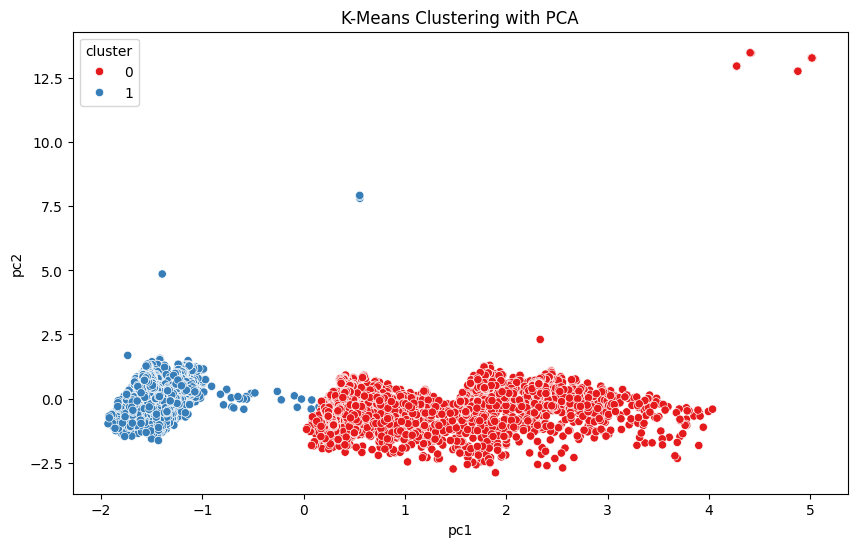

In [ ]:

from sklearn.cluster import DBSCAN
import numpy as np
X = data.drop(columns=['operation_result', 'passport_valid_to'])
clustering = DBSCAN(eps=3, min_samples=2).fit(X)
clustering.labels_
# DBSCAN ?
kmeans = KMeans(n_clusters=2, random_state=42)
kmeans.fit(X_scaled)
data['cluster'] = kmeans.labels_

from sklearn.decomposition import PCA

pca = PCA(n_components=2)
principal_components = pca.fit_transform(X_scaled)
df_pca = pd.DataFrame(data=principal_components, columns=['pc1', 'pc2'])
df_pca['cluster'] = data['cluster']

plt.figure(figsize=(10, 6))
sns.scatterplot(x='pc1', y='pc2', hue='cluster', data=df_pca, palette='Set1')
plt.title('K-Means Clustering with PCA')
plt.show()

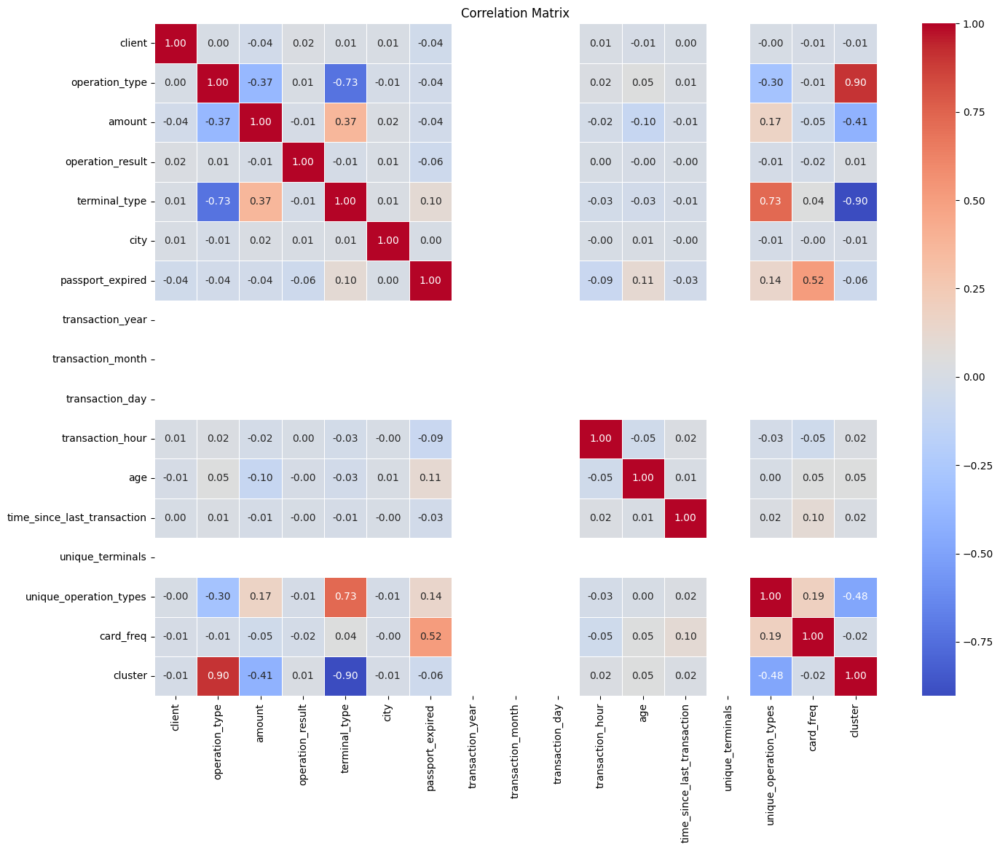

In [ ]:
data_num = data.select_dtypes(include=["float", "int"])
correlation_matrix = data_num.corr()

# Визуализация матрицы корреляций
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

In [ ]:
data.head()

,client,passport_valid_to,operation_type,amount,operation_result,terminal_type,city,passport_expired,transaction_year,transaction_month,transaction_day,transaction_hour,age,time_since_last_transaction,unique_terminals,unique_operation_types,card_freq,cluster
0,574,2024-08-16,0,229532.3,2,1,15,0,2024,5,17,0,45,0.0,1,1,1,0
1,1360,NaT,3,100.0,2,0,24,0,2024,5,17,0,72,0.0,1,1,4,1
2,1470,2045-06-18,4,2800.0,2,0,15,0,2024,5,17,0,24,0.0,1,1,1,1
3,788,NaT,3,3900.0,2,0,15,0,2024,5,17,0,78,0.0,1,1,2,1
4,411,2046-12-25,3,14800.0,2,0,15,0,2024,5,17,0,22,0.0,1,1,2,1


In [ ]:
# Посмотрим на распределение кластеров
cluster_counts = data['cluster'].value_counts()
print(cluster_counts)

# Выведем статистику по каждому кластеру
for cluster in data['cluster'].unique():
    print(f"Cluster {cluster} statistics:")
    print(data[data['cluster'] == cluster].describe())
    print("\n")

cluster
0    2568
1    2528
Name: count, dtype: int64
Cluster 0 statistics:
            client              passport_valid_to  operation_type  \
count  2568.000000                           1277     2568.000000   
mean    857.913551  2033-10-10 14:29:24.761159168        0.496495   
min       1.000000            1991-09-03 00:00:00        0.000000   
25%     445.000000            2028-09-25 00:00:00        0.000000   
50%     852.500000            2034-02-14 00:00:00        0.000000   
75%    1283.000000            2039-02-17 00:00:00        0.000000   
max    1703.000000            2049-04-04 00:00:00        3.000000   
std     495.709637                            NaN        0.865287   

              amount  operation_result  terminal_type         city  \
count    2568.000000       2568.000000    2568.000000  2568.000000   
mean   108624.786277          1.684969       1.500000    14.884735   
min       100.890000          0.000000       0.000000     1.000000   
25%      2086.797500  

In [ ]:
from sklearn.ensemble import IsolationForest

X = data.drop(columns=['operation_result', 'passport_valid_to'])

isolation_forest = IsolationForest(contamination=0.01, random_state=42)
isolation_forest.fit(X)

data['anomaly_score'] = isolation_forest.decision_function(X)
data['anomaly'] = isolation_forest.predict(X)
data['anomaly'] = data['anomaly'].map({1: 0, -1: 1})  # 1 - аномалия, 0 - нормальная

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

y = data['anomaly']

X = data.drop(columns=['anomaly', 'passport_valid_to'])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

feature_importances = model.feature_importances_
features = X.columns

data['fraud_probability'] = model.predict_proba(X)[:, 1]

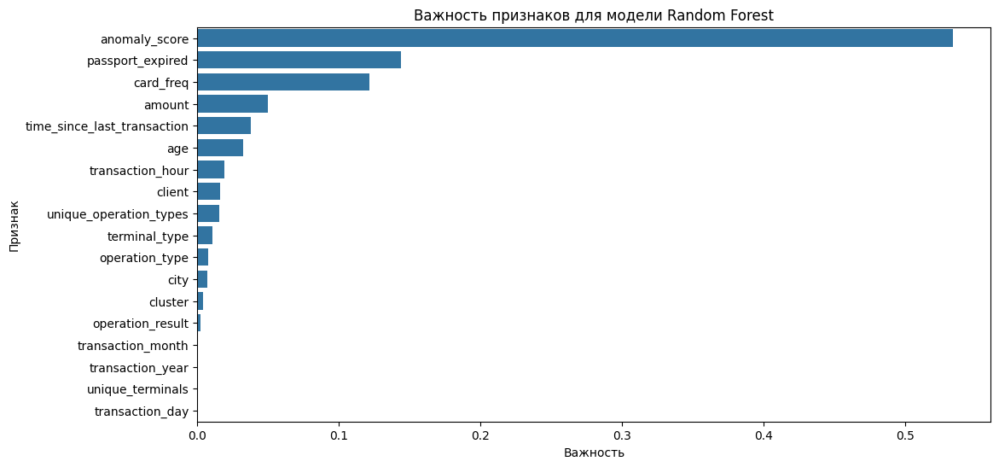

In [ ]:
importance_df = pd.DataFrame({
    'Feature': features,
    'Importance': feature_importances
}).sort_values(by='Importance', ascending=False)

plt.figure(figsize=(12, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title('Важность признаков для модели Random Forest')
plt.xlabel('Важность')
plt.ylabel('Признак')
plt.show()

In [ ]:
fraud_probability_counts = data['fraud_probability'].value_counts()
print("Counts of each unique fraud probability value:")
print(fraud_probability_counts)

Counts of each unique fraud probability value:
fraud_probability
0.00    4917
0.01      83
1.00      27
0.02      18
0.03      14
0.04       3
0.82       3
0.95       2
0.84       2
0.06       2
0.14       2
0.99       2
0.13       2
0.87       2
0.96       2
0.92       2
0.17       2
0.93       1
0.83       1
0.08       1
0.97       1
0.05       1
0.85       1
0.76       1
0.89       1
0.91       1
0.69       1
0.64       1
Name: count, dtype: int64


In [ ]:
high_fraud_probability_count = (data['fraud_probability'] > 0.7).sum()
high_fraud_probability_count

49

In [ ]:
fraudulent_transactions = data[data['fraud_probability'] == 1]

print(fraudulent_transactions.head())

print(f"Number of transactions with fraud probability equal to 1: {fraudulent_transactions.shape[0]}")

    client passport_valid_to  operation_type   amount  operation_result  \
56     463        1993-07-19               2  5408.15                 1   
58     463        1993-07-19               0  6649.74                 2   
59     463        1993-07-19               0  9273.77                 1   
60     463        1993-07-19               2  9396.47                 1   
61     463        1993-07-19               0  5111.92                 1   

    terminal_type  city  passport_expired  transaction_year  \
56              2    15                 1              2024   
58              2    15                 1              2024   
59              2    15                 1              2024   
60              2    15                 1              2024   
61              2    15                 1              2024   

    transaction_month  ...  transaction_hour  age  \
56                  5  ...                 0   76   
58                  5  ...                 0   76   
59         